### Cognition Project:

- VGG16 imagenet
    - results at different readout levels for a subset of imagenet (imagenette?)
        - freeze layers below at different layers and train a linear classifier on top of it, see performance as depth changes
        - confusion matrices
    - visualization response different layers to a picture 
    - visualization filter pattern different layers xxx
- heatmap imposition 
    - visualize examples of heatmap imposition xxx
    - visualize heatmap of failed preditions 
    - introducing noise over most/least important pixels (?) --> effect on prediction
- deep dream
    - different layers
        - generation from scratch
    - different params
    - different dataset
    - different model

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!tar -xvf /content/drive/MyDrive/Data/imagenette.tgz

In [ ]:
!tar -xvf /content/drive/MyDrive/Data/imagewoof.tgz

In [1]:
import warnings

warnings.filterwarnings("always")

In [2]:
import tensorflow as tf
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2 as cv
import json

from keras import layers
from keras import models
from keras.applications.vgg16 import VGG16
from keras import backend as K
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.callbacks import ModelCheckpoint

import os
import enum
from collections import namedtuple
import argparse
import numbers
import math

import torch
import torch.nn as nn
from torchvision import models
from torchvision import transforms
import torch.nn.functional as F
from torch.hub import download_url_to_file
import torchvision as tv

import scipy.cluster as cluster
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix

2021-12-27 12:03:32.865560: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2021-12-27 12:03:32.865660: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [3]:
tf.compat.v1.disable_eager_execution()

## Linear readouts at different levels of VGG-16 with Imagenette and Imagewoof

In [4]:
def preprocess_vgg16(x,y):
    x_processed = tf.keras.applications.vgg16.preprocess_input(x)
    y_processed = tf.keras.utils.to_categorical(y)
    return x_processed, y_processed

In [9]:
def prepare_dataset(dataset_path):
    targets = np.array([i for i in range(10) for j in range(200)])
    images = np.zeros(shape=(2000,224,224,3))
    categories = []
    
    for i in range(len(os.listdir(dataset_path))):
        category = os.listdir(dataset_path)[i]
        categories.append(category)
        category_path = os.path.join(dataset_path,category)
        for idx, picture in enumerate(os.listdir(category_path)[:200]):
            path = os.path.join(category_path, picture)
            img = image.load_img(path, target_size=(224,224))
            x = image.img_to_array(img)
            x = np.expand_dims(x, axis=0)
            images[i*200+idx] = x
        print(f"finished with category {category}")
        
    assert(images.shape==(2000,224,224,3))
    assert(targets.shape==(2000,))
    
    X_train, y_train = images, targets
    X_train, y_train = preprocess_vgg16(X_train, y_train)
    X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.25)
    X_test, X_valid, y_test, y_valid = train_test_split(X_valid, y_valid, test_size=0.5)
    
    category_labels = {k:v for k,v in enumerate(categories)}
    
    return (X_train, y_train), (X_valid, y_valid), (X_test, y_test), category_labels

In [6]:
def plot_examples(images, targets, category_labels):
    plt.figure(figsize=(16,8))
    for i in range(5):
        plt.subplot(1,5,i+1)
        rnd = np.random.randint(low=0,high=len(images))
        plt.imshow(images[rnd]/255.)
        print(f"idx: {rnd}, label {category_labels[targets[rnd]]}")

In [7]:
final_layers = [-2, -6, -10, -14, -17]

def get_results(X_train, y_train, X_valid, y_valid, X_test, y_test, verbose=1):
    
    accuracies = []
    conf_matrices = []
    histories = []
    failed_examples = []
    
    for final_layer in final_layers:
        model = VGG16(weights="imagenet", include_top=False, input_shape=(224,224,3), pooling="max")

        model2 = tf.keras.Model(model.input, model.layers[final_layer].output)

        for layer in model2.layers:
            layer.trainable = False

        flatten = tf.keras.layers.Flatten()(model2.output)
        output = tf.keras.layers.Dense(10,activation="softmax")(flatten)
        model = tf.keras.Model(inputs=model2.input,outputs=output)
        
        model.compile(optimizer=tf.keras.optimizers.Adam(),
              loss="categorical_crossentropy",
              metrics=["accuracy"])

        # save the best model with least validation loss
        callbacks = []
        callbacks.append(tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", verbose=1, patience=3, restore_best_weights=True))

        history = model.fit(X_train,y_train, batch_size=16,
                            epochs=5, validation_data=(X_valid, y_valid),
                            callbacks=callbacks, verbose=verbose)
        histories.append(history)
        
        _, accuracy = model.evaluate(X_test,y_test)
        accuracies.append(accuracy)
        
        preds = model.predict(X_test)
        conf_matrices.append(confusion_matrix(y_test, preds))
        
        mask = np.array(preds) != np.array(y_test)
        example_failed = X_test[mask][0]
        mistake_labels = (y_test[mask][0], preds[mask][0])
        failed_examples.append([example_failed, mistake_labels])
        
        print(f"\nFinished with final_layer {final_layer}\n")
    
    return accuracies, conf_matrices, histories, failed_examples

### Imagenette

In [ ]:
imagenette_path = "imagenette2-320/train/"

(X_train, y_train), (X_valid, y_valid), (X_test, y_test), category_labels = prepare_dataset(imagenette_path)

print(X_train.shape, y_train.shape)
print(X_valid.shape, y_valid.shape)
print(X_test.shape, y_test.shape)
print(category_labels)

finished with category n03425413
finished with category n03028079
finished with category n03417042
finished with category n03394916
finished with category n03888257
finished with category n01440764
finished with category n02102040
finished with category n03445777
finished with category n03000684
finished with category n02979186


In [ ]:
plot_examples(X_train, y_train, category_labels)

In [ ]:
accuracies_nette, conf_matrices_nette, histories_nette = get_results(X_train, y_train,
                                                                     X_valid, y_valid,
                                                                     X_test, y_test)

### Imagewoof

In [ ]:
imagewoof_path = "imagewoof2-320/train/"

(X_train_woof, y_train_woof), (X_valid, y_valid_woof), (X_test_woof, y_test_woof), category_labels_woof = prepare_dataset(imagewoof_path)

print(X_train_woof.shape, y_train_woof.shape)
print(X_valid_woof.shape, y_valid_woof.shape)
print(X_test_woof.shape, y_test_woof.shape)
print(category_labels_woof)

In [ ]:
plot_examples(X_train_woof, y_train_woof, category_labels_woof)

In [ ]:
accuracies_woof, conf_matrices_woof, histories_woof = get_results(X_train_woof, y_train_woof,
                                                                     X_valid_woof, y_valid_woof,
                                                                     X_test_woof, y_test_woof)

## Visualization response different layers to a picture 

## Visualization filter pattern different layers

In [ ]:
model = VGG16(weights="imagenet",include_top=False)

layer_name = "block3_conv1"
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index])
grads = K.gradients(loss, model.input)[0]
grads /= (K.sqrt(K.mean(K.square(grads)))+1e-5)
iterate = K.function([model.input], [loss, grads])

loss_value, grads_value = iterate([np.zeros((1,150,150,3))])

input_img_data = np.random.random((1,150,150,3)) * 20 + 128.
step = 1
for i in range(40):
    loss_value, grads_value = iterate([input_img_data])
    input_img_data += grads_value * step

In [ ]:
def deprocess_image(x):
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1
    
    x += 0.5
    x = np.clip(x,0,1)
    
    x *= 255
    x = np.clip(x,0,255).astype("uint8")
    return x

def generate_pattern(layer_name, filter_index, size=150):
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:,:,:,filter_index])
    
    grads = K.gradients(loss, model.input)[0]
    grads /= (K.sqrt(K.mean(K.square(grads)))+1e-5)
    iterate = K.function([model.input],[loss,grads])
    
    input_img_data = np.random.random((1,size,size,3))*20+128.
    
    step = 1
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

In [ ]:
def plot_layers_filters(layer_names):
    for k,layer_name in enumerate(layer_names):
        size = 64
        margin = 5

        results = np.zeros((8*size+7*margin, 8*size+7*margin,3))

        for i in range(8):
            for j in range(8):
                filter_img = generate_pattern(layer_name, i + (j*8), size=size)

                horizontal_start = i * size + i* margin
                horizontal_end = horizontal_start + size
                vertical_start = j * size + j * margin
                vertical_end = vertical_start + size
                results[horizontal_start:horizontal_end,
                        vertical_start:vertical_end,:] = filter_img

        plt.figure(figsize=(15,15))
        plt.imshow(results.astype(np.uint8))

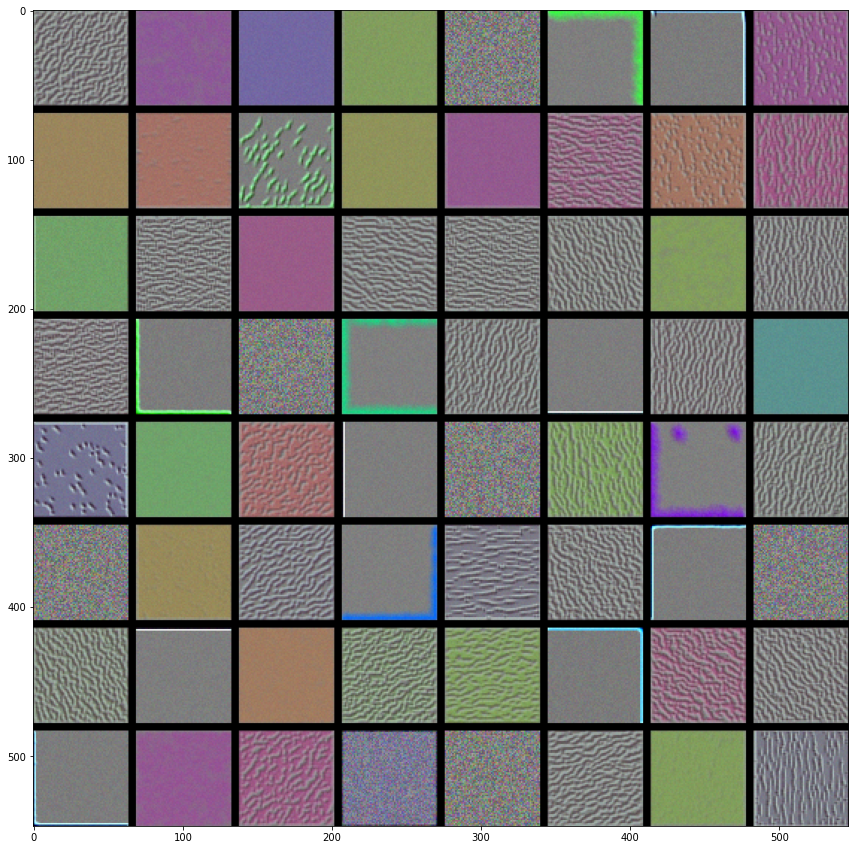

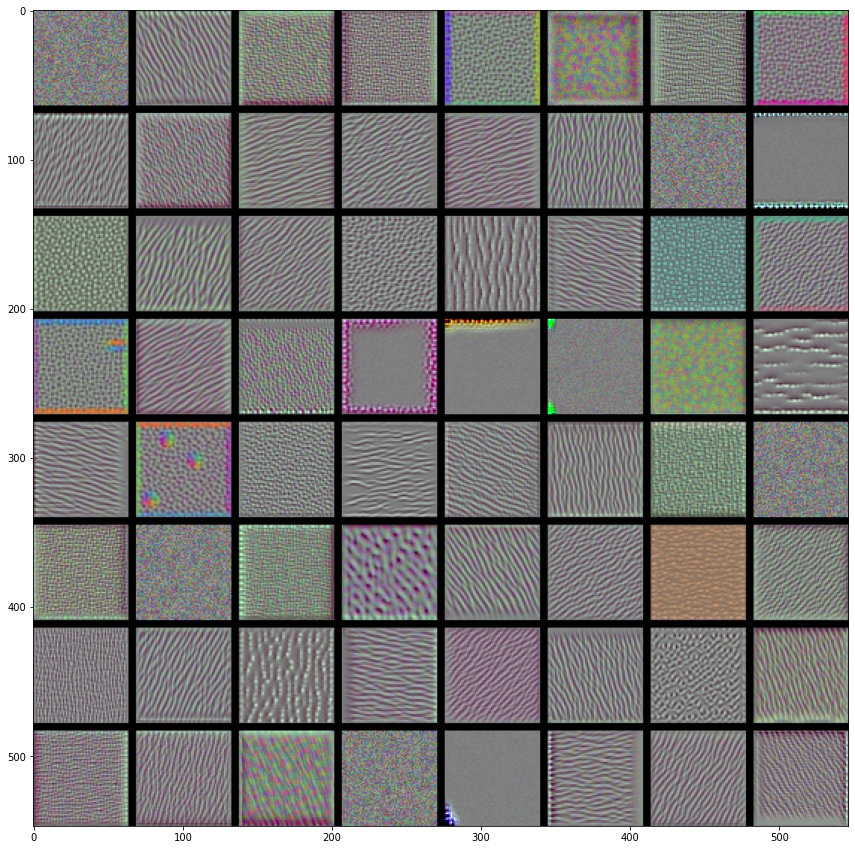

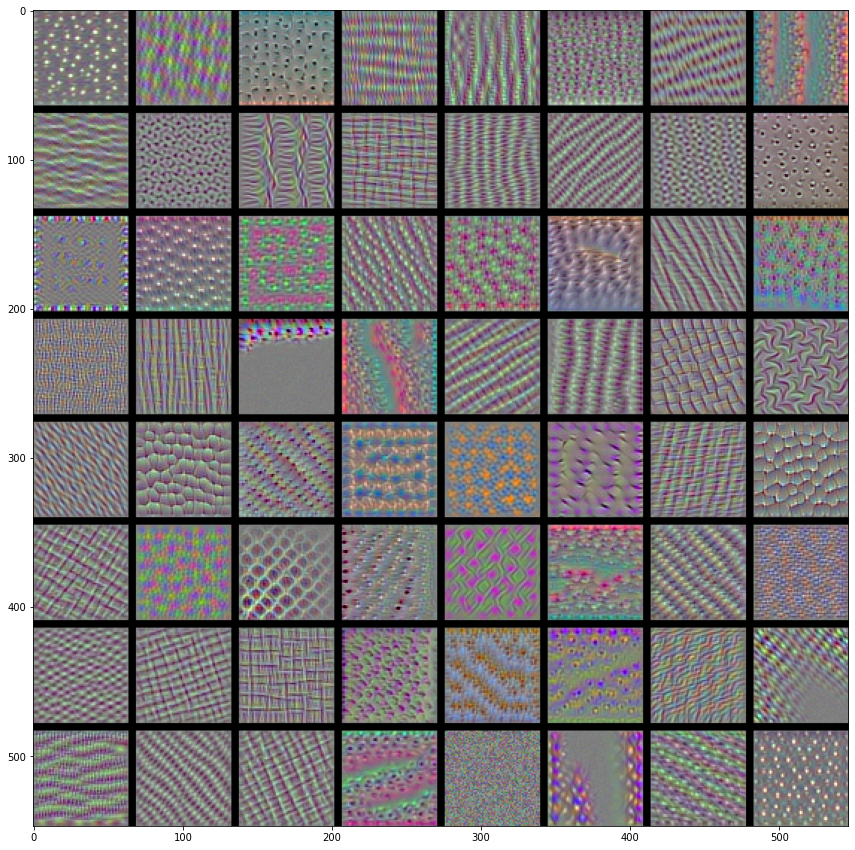

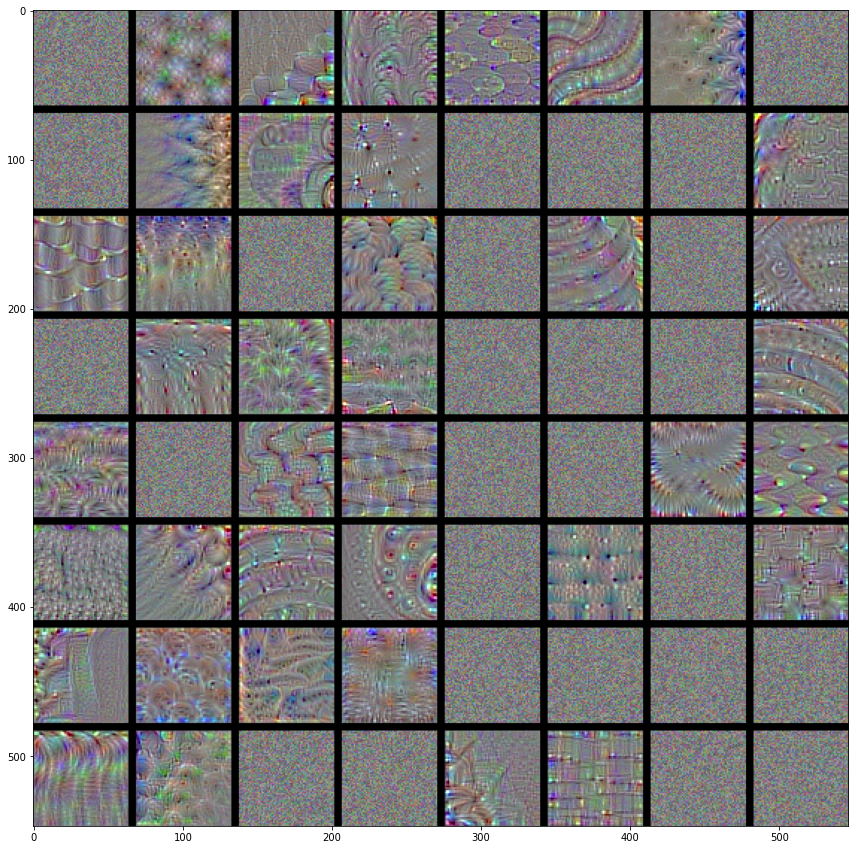

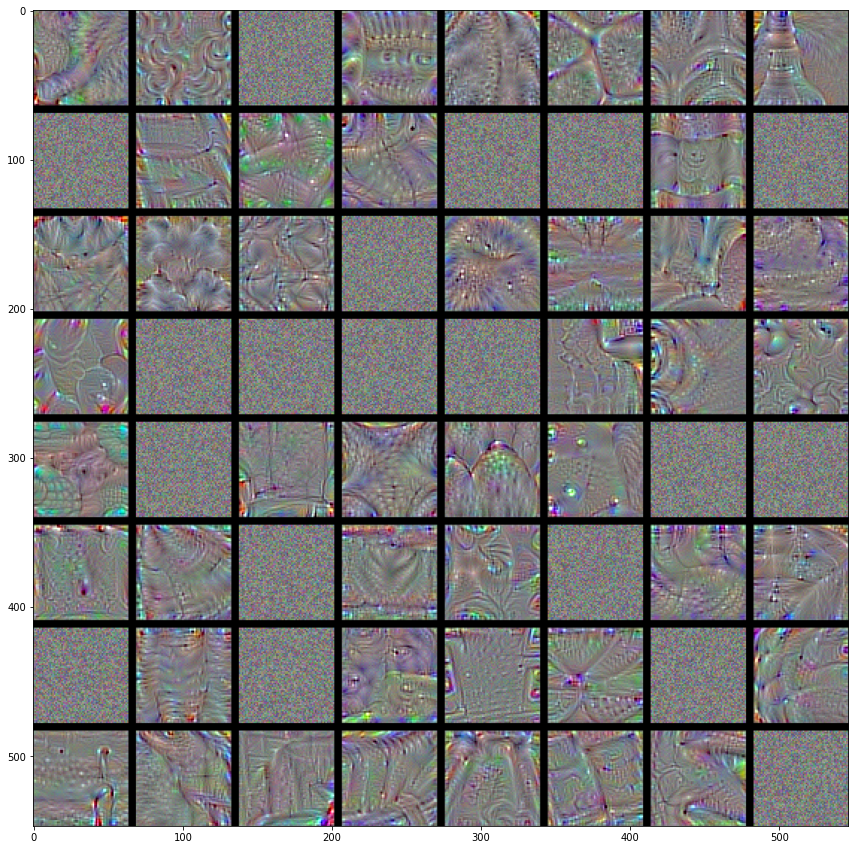

In [ ]:
plot_layers_filters(["block1_conv1","block2_conv1","block3_conv1","block4_conv3","block5_conv1"])

## Heatmap imposition

In [ ]:
model = VGG16(weights="imagenet")

553476096/553467096 [==============================] - 8s 0us/step


In [ ]:
def plot_heatmap_decision(img_path):

    img = image.load_img(img_path, target_size=(224,224))
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)

    preds = model.predict(x)
    print("Predicted:",decode_predictions(preds,top=3)[0])

    idx = np.argmax(preds[0])
    gond_output = model.output[:, idx]
    last_conv_layer = model.get_layer("block5_conv3")

    grads = K.gradients(gond_output, last_conv_layer.output)[0]
    pooled_grads = K.mean(grads, axis=(0,1,2))
    iterate = K.function([model.input],[pooled_grads,last_conv_layer.output[0]])
    pooled_grads_value, conv_layer_output_value = iterate([x])

    for i in range(512):
        conv_layer_output_value[:, :, i] *= pooled_grads_value[i]

    heatmap = np.mean(conv_layer_output_value, axis=-1)
    heatmap = np.maximum(heatmap, 0 )
    heatmap /= np.max(heatmap)

    original_img = cv.imread(img_path)

    impose_heatmap = cv.resize(heatmap, (original_img.shape[1], original_img.shape[0]))
    impose_heatmap = np.uint8(255 * impose_heatmap)
    impose_heatmap = cv.applyColorMap(impose_heatmap, cv.COLORMAP_JET)
    superimposed_img = impose_heatmap * 0.75 + original_img
    cv.imwrite(img_path + "_superimposed.jpeg",superimposed_img)
    superimposed_img = image.load_img(img_path + "_superimposed.jpeg", target_size=(224,224))

    plt.figure(figsize=(16,8))
    plt.subplot(131)
    plt.axis("off")
    plt.imshow(img)
    plt.subplot(132)
    plt.axis("off")
    plt.imshow(heatmap)
    plt.subplot(133)
    plt.axis("off")
    plt.imshow(superimposed_img)
    plt.show()

Predicted: [('n03447447', 'gondola', 0.99484456), ('n03877845', 'palace', 0.001532547), ('n02951358', 'canoe', 0.00086153246)]


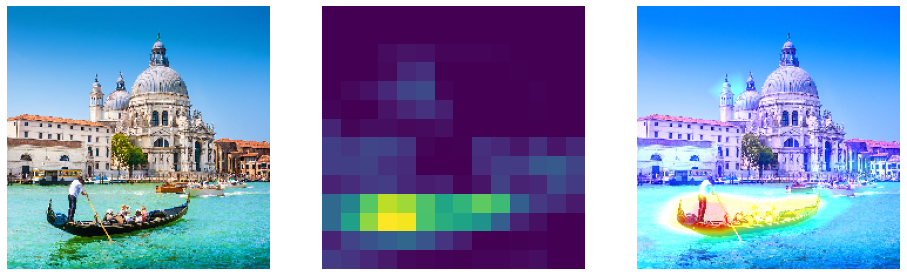

Predicted: [('n03447447', 'gondola', 0.9987212), ('n02980441', 'castle', 0.0009861941), ('n03216828', 'dock', 0.00013424414)]


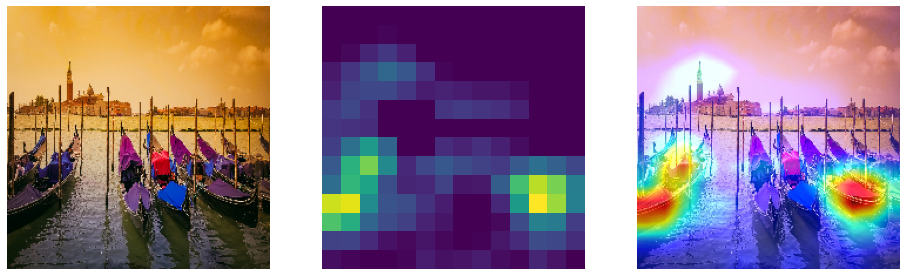

Predicted: [('n03447447', 'gondola', 0.99561983), ('n03216828', 'dock', 0.002638857), ('n02859443', 'boathouse', 0.00089182507)]


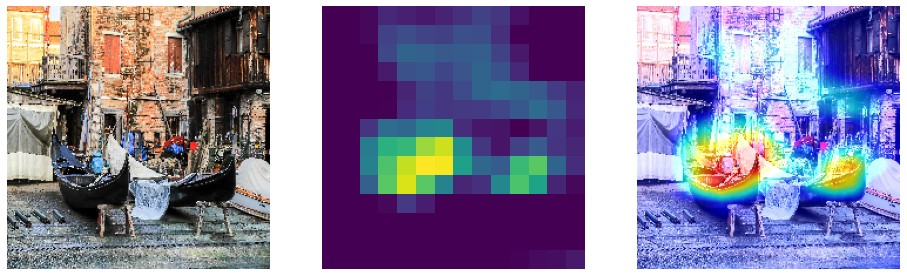

Predicted: [('n02134084', 'ice_bear', 0.9714029), ('n02104029', 'kuvasz', 0.017057514), ('n02111500', 'Great_Pyrenees', 0.009715984)]


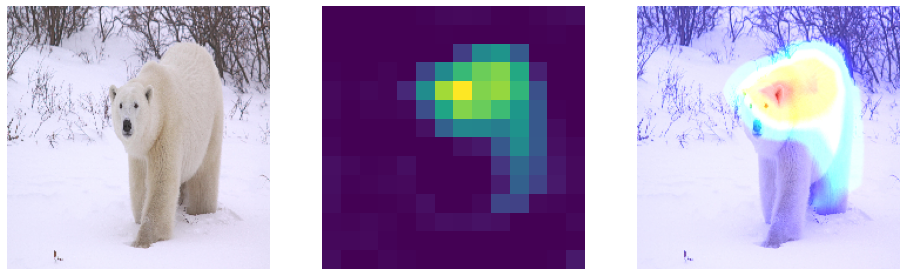

Predicted: [('n01770393', 'scorpion', 0.9969812), ('n01985128', 'crayfish', 0.0009268321), ('n02168699', 'long-horned_beetle', 0.0007578592)]


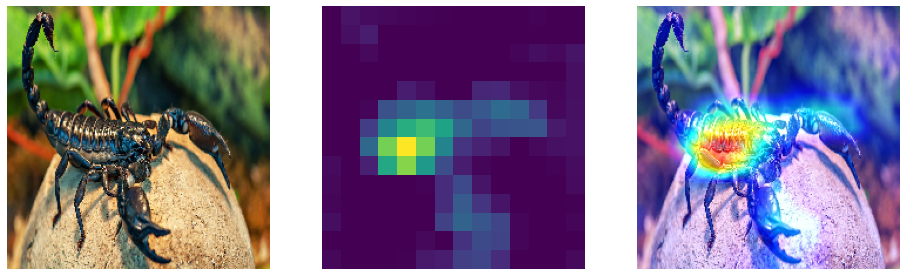

In [ ]:
plot_heatmap_decision("gondola_original.jpeg")
plot_heatmap_decision("gondola_no_gondoleer.jpeg")
plot_heatmap_decision("gondola_in_secca.jpeg")  
plot_heatmap_decision("ice_bear.jpeg")
plot_heatmap_decision("scorpion.jpeg")

## Deep dream

In [ ]:
# The 2 datasets we'll be leveraging
class SupportedPretrainedWeights(enum.Enum):
    IMAGENET = 0
    PLACES_365 = 1
    

# The 2 models we'll be using
class SupportedModels(enum.Enum):
    VGG16_EXPERIMENTAL = 0,
    RESNET50 = 1
    

# Commonly used paths, let's define them here as constants
DATA_DIR_PATH = os.path.join(os.getcwd(), 'data')
INPUT_DATA_PATH = os.path.join(DATA_DIR_PATH, 'input')
BINARIES_PATH = os.path.join(os.getcwd(), 'models', 'binaries')
OUT_IMAGES_PATH = os.path.join(DATA_DIR_PATH, 'out-images')

# Make sure these exist as the rest of the code relies on it
os.makedirs(BINARIES_PATH, exist_ok=True)
os.makedirs(OUT_IMAGES_PATH, exist_ok=True)

DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")  # checking whether you have a GPU

# Images will be normalized using these, because the CNNs were trained with normalized images as well!
IMAGENET_MEAN_1 = np.array([0.485, 0.456, 0.406], dtype=np.float32)
IMAGENET_STD_1 = np.array([0.229, 0.224, 0.225], dtype=np.float32)

In [ ]:
class Vgg16Experimental(torch.nn.Module):
    
    def __init__(self, pretrained_weights, requires_grad=False, show_progress=False):
        super().__init__()

        # Only ImageNet weights are supported for now for this model
        if pretrained_weights == SupportedPretrainedWeights.IMAGENET.name:
            vgg16 = models.vgg16(pretrained=True, progress=show_progress).eval()
        else:
            raise Exception(f'Pretrained weights {pretrained_weights} not yet supported for {self.__class__.__name__} model.')

        # I just used the official PyTorch implementation to figure out how to dissect VGG16:
        # https://github.com/pytorch/vision/blob/master/torchvision/models/vgg.py
        vgg_pretrained_features = vgg16.features

        # I've exposed the best/most interesting layers in my subjective opinion (mp5 is not that good though)
        self.layer_names = ['relu1_1','relu1_2','relu2_2','relu3_3', 'relu4_1', 'relu4_2', 'relu4_3', 'relu5_1', 'relu5_2', 'relu5_3', 'mp5']

        # 31 layers in total for the VGG16
        self.conv1_1 = vgg_pretrained_features[0]
        self.relu1_1 = vgg_pretrained_features[1]
        self.conv1_2 = vgg_pretrained_features[2]
        self.relu1_2 = vgg_pretrained_features[3]
        self.max_pooling1 = vgg_pretrained_features[4]
        self.conv2_1 = vgg_pretrained_features[5]
        self.relu2_1 = vgg_pretrained_features[6]
        self.conv2_2 = vgg_pretrained_features[7]
        self.relu2_2 = vgg_pretrained_features[8]
        self.max_pooling2 = vgg_pretrained_features[9]
        self.conv3_1 = vgg_pretrained_features[10]
        self.relu3_1 = vgg_pretrained_features[11]
        self.conv3_2 = vgg_pretrained_features[12]
        self.relu3_2 = vgg_pretrained_features[13]
        self.conv3_3 = vgg_pretrained_features[14]
        self.relu3_3 = vgg_pretrained_features[15]
        self.max_pooling3 = vgg_pretrained_features[16]
        self.conv4_1 = vgg_pretrained_features[17]
        self.relu4_1 = vgg_pretrained_features[18]
        self.conv4_2 = vgg_pretrained_features[19]
        self.relu4_2 = vgg_pretrained_features[20]
        self.conv4_3 = vgg_pretrained_features[21]
        self.relu4_3 = vgg_pretrained_features[22]
        self.max_pooling4 = vgg_pretrained_features[23]
        self.conv5_1 = vgg_pretrained_features[24]
        self.relu5_1 = vgg_pretrained_features[25]
        self.conv5_2 = vgg_pretrained_features[26]
        self.relu5_2 = vgg_pretrained_features[27]
        self.conv5_3 = vgg_pretrained_features[28]
        self.relu5_3 = vgg_pretrained_features[29]
        self.max_pooling5 = vgg_pretrained_features[30]

        # Turn off these because we'll be using a pretrained network
        # if we didn't do this PyTorch would be saving gradients and eating up precious memory!
        if not requires_grad:
            for param in self.parameters():
                param.requires_grad = False

    # Just expose every single layer during the forward pass
    def forward(self, x):
        x = self.conv1_1(x)
        conv1_1 = x
        x = self.relu1_1(x)
        relu1_1 = x
        x = self.conv1_2(x)
        conv1_2 = x
        x = self.relu1_2(x)
        relu1_2 = x
        x = self.max_pooling1(x)
        x = self.conv2_1(x)
        conv2_1 = x
        x = self.relu2_1(x)
        relu2_1 = x
        x = self.conv2_2(x)
        conv2_2 = x
        x = self.relu2_2(x)
        relu2_2 = x
        x = self.max_pooling2(x)
        x = self.conv3_1(x)
        conv3_1 = x
        x = self.relu3_1(x)
        relu3_1 = x
        x = self.conv3_2(x)
        conv3_2 = x
        x = self.relu3_2(x)
        relu3_2 = x
        x = self.conv3_3(x)
        conv3_3 = x
        x = self.relu3_3(x)
        relu3_3 = x
        x = self.max_pooling3(x)
        x = self.conv4_1(x)
        conv4_1 = x
        x = self.relu4_1(x)
        relu4_1 = x
        x = self.conv4_2(x)
        conv4_2 = x
        x = self.relu4_2(x)
        relu4_2 = x
        x = self.conv4_3(x)
        conv4_3 = x
        x = self.relu4_3(x)
        relu4_3 = x
        x = self.max_pooling4(x)
        x = self.conv5_1(x)
        conv5_1 = x
        x = self.relu5_1(x)
        relu5_1 = x
        x = self.conv5_2(x)
        conv5_2 = x
        x = self.relu5_2(x)
        relu5_2 = x
        x = self.conv5_3(x)
        conv5_3 = x
        x = self.relu5_3(x)
        relu5_3 = x
        mp5 = self.max_pooling5(x)

        # Finally, expose only the layers that you want to experiment with here
        vgg_outputs = namedtuple("VggOutputs", self.layer_names)
        out = vgg_outputs(relu1_1, relu1_2, relu2_2, relu3_3, relu4_1, relu4_2, relu4_3, relu5_1, relu5_2, relu5_3, mp5)

        return out
    
    
def fetch_and_prepare_model(model_type, pretrained_weights):
    if model_type == SupportedModels.VGG16_EXPERIMENTAL.name:
        model = Vgg16Experimental(pretrained_weights, requires_grad=False, show_progress=True).to(DEVICE)
    elif model_type == SupportedModels.RESNET50.name:
        # We'll define the ResNet50 later
        model = ResNet50(pretrained_weights, requires_grad=False, show_progress=True).to(DEVICE)
    else:
        raise Exception('Model not yet supported.')
    return model

In [ ]:
def load_image(img_path, target_shape=None):
    if not os.path.exists(img_path):
        raise Exception(f'Path does not exist: {img_path}')
    img = cv.imread(img_path)[:, :, ::-1]  # [:, :, ::-1] converts BGR (opencv format...) into RGB

    if target_shape is not None:  # resize section
        if isinstance(target_shape, int) and target_shape != -1:  # scalar -> implicitly setting the width
            current_height, current_width = img.shape[:2]
            new_width = target_shape
            new_height = int(current_height * (new_width / current_width))
            img = cv.resize(img, (new_width, new_height), interpolation=cv.INTER_CUBIC)
        else:  # set both dimensions to target shape
            img = cv.resize(img, (target_shape[1], target_shape[0]), interpolation=cv.INTER_CUBIC)

    # This need to go after resizing - otherwise cv.resize will push values outside of [0,1] range
    img = img.astype(np.float32)  # convert from uint8 to float32
    img /= 255.0  # get to [0, 1] range
    return img


# config is just a shared dictionary that you'll be seeing used everywhere, but we'll define it a bit later.
# For the time being think of it as an oracle - whatever the function needs - config provides ^^
def save_and_maybe_display_image(config, dump_img, name_modifier=None):
    assert isinstance(dump_img, np.ndarray), f'Expected numpy array got {type(dump_img)}.'

    # Step 1: figure out the dump dir location
    dump_dir = config['dump_dir']
    os.makedirs(dump_dir, exist_ok=True)

    # Step 2: define the output image name
    if name_modifier is not None:
        dump_img_name = str(name_modifier).zfill(6) + '.jpg'
    else:
        dump_img_name = build_image_name(config)

    if dump_img.dtype != np.uint8:
        dump_img = (dump_img*255).astype(np.uint8)

    # Step 3: write image to the file system
    # ::-1 because opencv expects BGR (and not RGB) format...
    dump_path = os.path.join(dump_dir, dump_img_name)
    cv.imwrite(dump_path, dump_img[:, :, ::-1])

    # Step 4: potentially display/plot the image
    if config['should_display']:
        fig = plt.figure(figsize=(7.5,5), dpi=100)  # otherwise plots are really small in Jupyter Notebook
        plt.imshow(dump_img)
        plt.show()

    return dump_path


# This function makes sure we can later reconstruct the image using the information encoded into the filename!
# Again don't worry about all the arguments we'll define them later
def build_image_name(config):
    input_name = 'rand_noise' if config['use_noise'] else config['input'].split('.')[0]
    layers = '_'.join(config['layers_to_use'])
    # Looks awful but makes the creation process transparent for other creators
    img_name = f'{input_name}_width_{config["img_width"]}_model_{config["model_name"]}_{config["pretrained_weights"]}_{layers}_pyrsize_{config["pyramid_size"]}_pyrratio_{config["pyramid_ratio"]}_iter_{config["num_gradient_ascent_iterations"]}_lr_{config["lr"]}_shift_{config["spatial_shift_size"]}_smooth_{config["smoothing_coefficient"]}.jpg'
    return img_name

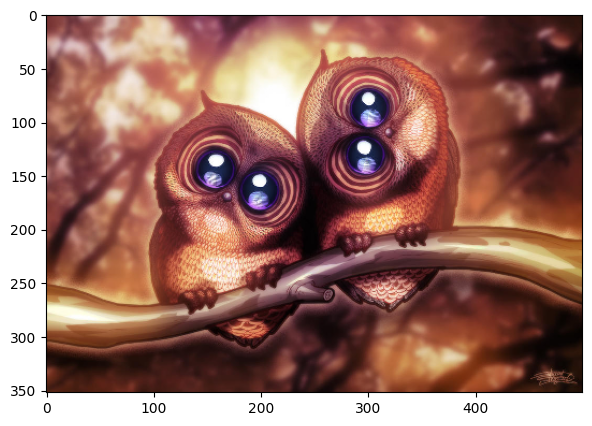

In [ ]:
input_img_name = 'owls.jpeg'  # checked in, I'll be using it as the running example
img_width = 500  # arbitrary
img_path = os.path.join(INPUT_DATA_PATH, input_img_name)
img = load_image(img_path, target_shape=img_width)

fig = plt.figure(figsize=(7.5,5), dpi=100)  # otherwise plots are really small in Jupyter Notebook
plt.imshow(img)
plt.show()

In [ ]:
# mean/std normalization - ImageNet's mean and std capture the statistics of natural images pretty nicely.
# This works for Places365 dataset as well (keep in mind you might have to change it if your dataset is way different)
def pre_process_numpy_img(img):
    assert isinstance(img, np.ndarray), f'Expected numpy image got {type(img)}'

    img = (img - IMAGENET_MEAN_1) / IMAGENET_STD_1  # normalize image
    return img


def post_process_numpy_img(img):
    assert isinstance(img, np.ndarray), f'Expected numpy image got {type(img)}'

    if img.shape[0] == 3:  # if channel-first format move to channel-last (CHW -> HWC)
        img = np.moveaxis(img, 0, 2)

    mean = IMAGENET_MEAN_1.reshape(1, 1, -1)
    std = IMAGENET_STD_1.reshape(1, 1, -1)
    img = (img * std) + mean  # de-normalize
    img = np.clip(img, 0., 1.)  # make sure it's in the [0, 1] range

    return img


def pytorch_input_adapter(img):
    # shape = (1, 3, H, W)
    tensor = transforms.ToTensor()(img).to(DEVICE).unsqueeze(0)
    tensor.requires_grad = True  # we need to collect gradients for the input image
    return tensor


def pytorch_output_adapter(tensor):
    # Push to CPU, detach from the computational graph, convert from (1, 3, H, W) tensor into (H, W, 3) numpy image
    return np.moveaxis(tensor.to('cpu').detach().numpy()[0], 0, 2)


# Adds stochasticity to the algorithm and makes the results more diverse
def random_circular_spatial_shift(tensor, h_shift, w_shift, should_undo=False):
    if should_undo:
        h_shift = -h_shift
        w_shift = -w_shift
    with torch.no_grad():
        rolled = torch.roll(tensor, shifts=(h_shift, w_shift), dims=(2, 3))
        rolled.requires_grad = True
        return rolled

In [ ]:
# again treat config as an oracle
def get_new_shape(config, original_shape, current_pyramid_level):
    SHAPE_MARGIN = 10
    pyramid_ratio = config['pyramid_ratio']
    pyramid_size = config['pyramid_size']
    exponent = current_pyramid_level - pyramid_size + 1  # this one will be negative so we're dividing the original img shape
    new_shape = np.round(np.float32(original_shape) * (pyramid_ratio**exponent)).astype(np.int32)

    if new_shape[0] < SHAPE_MARGIN or new_shape[1] < SHAPE_MARGIN:
        print(f'Pyramid size {config["pyramid_size"]} with pyramid ratio {config["pyramid_ratio"]} gives too small pyramid levels with size={new_shape}')
        print(f'Please change the parameters.')
        exit(0)

    return new_shape

In [ ]:
def deep_dream_static_image(config, img=None):
    model = fetch_and_prepare_model(config['model_name'], config['pretrained_weights'])

    try:
        layer_ids_to_use = [model.layer_names.index(layer_name) for layer_name in config['layers_to_use']]
    except Exception as e:  # making sure you set the correct layer name for this specific model
        print(f'Invalid layer names {[layer_name for layer_name in config["layers_to_use"]]}.')
        print(f'Available layers for model {config["model_name"]} are {model.layer_names}.')
        return

    if img is None:  # load either the provided image or start from a pure noise image
        img_path = os.path.join(INPUT_DATA_PATH, config['input'])
        # load a numpy, [0, 1] range, channel-last, RGB image
        img = load_image(img_path, target_shape=config['img_width'])
        if config['use_noise']:
            shape = img.shape
            img = np.random.uniform(low=0.0, high=1.0, size=shape).astype(np.float32)

    img = pre_process_numpy_img(img)
    original_shape = img.shape[:-1]  # save initial height and width

    # Note: simply rescaling the whole result (and not only details, see original implementation) gave me better results
    # Going from smaller to bigger resolution (from pyramid top to bottom)
    for pyramid_level in range(config['pyramid_size']):
        new_shape = get_new_shape(config, original_shape, pyramid_level)
        img = cv.resize(img, (new_shape[1], new_shape[0]))  # resize depending on the current pyramid level
        input_tensor = pytorch_input_adapter(img)  # convert to trainable tensor

        for iteration in range(config['num_gradient_ascent_iterations']):
            
            # Introduce some randomness, it will give us more diverse results especially when you're making videos
            h_shift, w_shift = np.random.randint(-config['spatial_shift_size'], config['spatial_shift_size'] + 1, 2)
            input_tensor = random_circular_spatial_shift(input_tensor, h_shift, w_shift)

            # This is where the magic happens, treat it as a black box until the next cell
            gradient_ascent(config, model, input_tensor, layer_ids_to_use, iteration)

            # Roll back by the same amount as above (hence should_undo=True)
            input_tensor = random_circular_spatial_shift(input_tensor, h_shift, w_shift, should_undo=True)

        img = pytorch_output_adapter(input_tensor)

    return post_process_numpy_img(img)

In [ ]:
LOWER_IMAGE_BOUND = torch.tensor((-IMAGENET_MEAN_1 / IMAGENET_STD_1).reshape(1, -1, 1, 1)).to(DEVICE)
UPPER_IMAGE_BOUND = torch.tensor(((1 - IMAGENET_MEAN_1) / IMAGENET_STD_1).reshape(1, -1, 1, 1)).to(DEVICE)


def gradient_ascent(config, model, input_tensor, layer_ids_to_use, iteration):
    # Step 0: Feed forward pass
    out = model(input_tensor)

    # Step 1: Grab activations/feature maps of interest
    activations = [out[layer_id_to_use] for layer_id_to_use in layer_ids_to_use]

    # Step 2: Calculate loss over activations
    losses = []
    for layer_activation in activations:
        # Use torch.norm(torch.flatten(layer_activation), p) with p=2 for L2 loss and p=1 for L1 loss. 
        # But I'll use the MSE as it works really good, I didn't notice any serious change when going to L1/L2.
        # using torch.zeros_like as if we wanted to make activations as small as possible but we'll do gradient ascent
        # and that will cause it to actually amplify whatever the network "sees" thus yielding the famous DeepDream look
        loss_component = torch.nn.MSELoss(reduction='mean')(layer_activation, torch.zeros_like(layer_activation))
        losses.append(loss_component)

    loss = torch.mean(torch.stack(losses))
    loss.backward()

    # Step 3: Process image gradients (smoothing + normalization, more an art then a science)
    grad = input_tensor.grad.data

    # Applies 3 Gaussian kernels and thus "blurs" or smoothens the gradients and gives visually more pleasing results
    # We'll see the details of this one in the next cell and that's all, you now understand DeepDream!
    sigma = ((iteration + 1) / config['num_gradient_ascent_iterations']) * 2.0 + config['smoothing_coefficient']
    smooth_grad = CascadeGaussianSmoothing(kernel_size=9, sigma=sigma)(grad)  # "magic number" 9 just works well

    # Normalize the gradients (make them have mean = 0 and std = 1)
    # I didn't notice any big difference normalizing the mean as well - feel free to experiment
    g_std = torch.std(smooth_grad)
    g_mean = torch.mean(smooth_grad)
    smooth_grad = smooth_grad - g_mean
    smooth_grad = smooth_grad / g_std

    # Step 4: Update image using the calculated gradients (gradient ascent step)
    input_tensor.data += config['lr'] * smooth_grad

    # Step 5: Clear gradients and clamp the data (otherwise values would explode to +- "infinity")
    input_tensor.grad.data.zero_()
    input_tensor.data = torch.max(torch.min(input_tensor, UPPER_IMAGE_BOUND), LOWER_IMAGE_BOUND)

In [ ]:
class CascadeGaussianSmoothing(nn.Module):
    """
    Apply gaussian smoothing separately for each channel (depthwise convolution).

    Arguments:
        kernel_size (int, sequence): Size of the gaussian kernel.
        sigma (float, sequence): Standard deviation of the gaussian kernel.

    """
    def __init__(self, kernel_size, sigma):
        super().__init__()

        if isinstance(kernel_size, numbers.Number):
            kernel_size = [kernel_size, kernel_size]

        cascade_coefficients = [0.5, 1.0, 2.0]  # std multipliers, hardcoded to use 3 different Gaussian kernels
        sigmas = [[coeff * sigma, coeff * sigma] for coeff in cascade_coefficients]  # isotropic Gaussian

        self.pad = int(kernel_size[0] / 2)  # assure we have the same spatial resolution

        # The gaussian kernel is the product of the gaussian function of each dimension.
        kernels = []
        meshgrids = torch.meshgrid([torch.arange(size, dtype=torch.float32) for size in kernel_size])
        for sigma in sigmas:
            kernel = torch.ones_like(meshgrids[0])
            for size_1d, std_1d, grid in zip(kernel_size, sigma, meshgrids):
                mean = (size_1d - 1) / 2
                kernel *= 1 / (std_1d * math.sqrt(2 * math.pi)) * torch.exp(-((grid - mean) / std_1d) ** 2 / 2)
            kernels.append(kernel)

        gaussian_kernels = []
        for kernel in kernels:
            # Normalize - make sure sum of values in gaussian kernel equals 1.
            kernel = kernel / torch.sum(kernel)
            # Reshape to depthwise convolutional weight
            kernel = kernel.view(1, 1, *kernel.shape)
            kernel = kernel.repeat(3, 1, 1, 1)
            kernel = kernel.to(DEVICE)

            gaussian_kernels.append(kernel)

        self.weight1 = gaussian_kernels[0]
        self.weight2 = gaussian_kernels[1]
        self.weight3 = gaussian_kernels[2]
        self.conv = F.conv2d

    def forward(self, input):
        input = F.pad(input, [self.pad, self.pad, self.pad, self.pad], mode='reflect')

        # Apply Gaussian kernels depthwise over the input (hence groups equals the number of input channels)
        # shape = (1, 3, H, W) -> (1, 3, H, W)
        num_in_channels = input.shape[1]
        grad1 = self.conv(input, weight=self.weight1, groups=num_in_channels)
        grad2 = self.conv(input, weight=self.weight2, groups=num_in_channels)
        grad3 = self.conv(input, weight=self.weight3, groups=num_in_channels)

        return (grad1 + grad2 + grad3) / 3

In [ ]:
# Only a small subset is exposed by design to avoid cluttering
parser = argparse.ArgumentParser()

# Common params
parser.add_argument("--input", type=str, help="Input IMAGE or VIDEO name that will be used for dreaming", default='figures.jpg')
parser.add_argument("--img_width", type=int, help="Resize input image to this width", default=600)
parser.add_argument("--layers_to_use", type=str, nargs='+', help="Layer whose activations we should maximize while dreaming", default=['relu4_3'])
parser.add_argument("--model_name", choices=[m.name for m in SupportedModels],
                    help="Neural network (model) to use for dreaming", default=SupportedModels.VGG16_EXPERIMENTAL.name)
parser.add_argument("--pretrained_weights", choices=[pw.name for pw in SupportedPretrainedWeights],
                    help="Pretrained weights to use for the above model", default=SupportedPretrainedWeights.IMAGENET.name)

# Main params for experimentation (especially pyramid_size and pyramid_ratio)
parser.add_argument("--pyramid_size", type=int, help="Number of images in an image pyramid", default=4)
parser.add_argument("--pyramid_ratio", type=float, help="Ratio of image sizes in the pyramid", default=1.8)
parser.add_argument("--num_gradient_ascent_iterations", type=int, help="Number of gradient ascent iterations", default=10)
parser.add_argument("--lr", type=float, help="Learning rate i.e. step size in gradient ascent", default=0.09)

# You usually won't need to change these as often
parser.add_argument("--should_display", type=bool, help="Display intermediate dreaming results", default=False)
parser.add_argument("--spatial_shift_size", type=int, help='Number of pixels to randomly shift image before grad ascent', default=32)
parser.add_argument("--smoothing_coefficient", type=float, help='Directly controls standard deviation for gradient smoothing', default=0.5)
parser.add_argument("--use_noise", type=bool, help="Use noise as a starting point instead of input image", default=False)
args = parser.parse_args('')  # important to put '' in Jupyter otherwise it will complain

# Wrapping configuration into a dictionary
config = dict()
for arg in vars(args):
    config[arg] = getattr(args, arg)
config['dump_dir'] = os.path.join(OUT_IMAGES_PATH, f'{config["model_name"]}_{config["pretrained_weights"]}')
config['input'] = os.path.basename(config['input'])  # handle absolute and relative paths

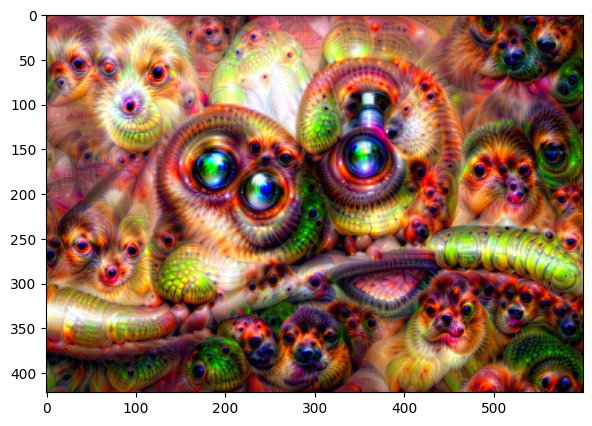

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



In [ ]:
config["input"] = "owls.jpeg"
config['pyramid_size'] = 3

img = deep_dream_static_image(config)  # yep a single liner

config['should_display'] = True
dump_path = save_and_maybe_display_image(config, img)
print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

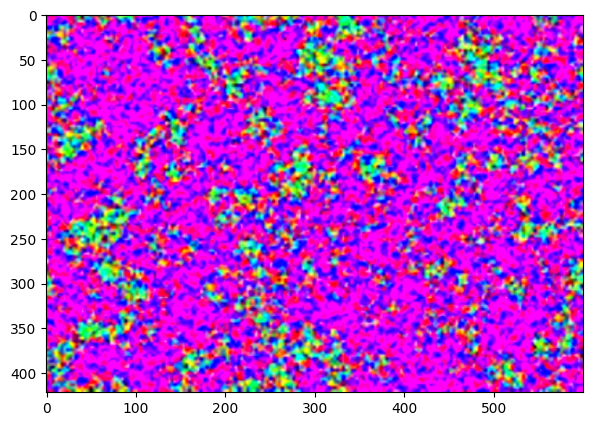

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/rand_noise_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu1_2_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



In [ ]:
config['use_noise'] = True  # variable under test
config['layers_to_use'] = ["relu1_2"]
config['should_display'] = True

img = deep_dream_static_image(config)
dump_path = save_and_maybe_display_image(config, img)
print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

config['layers_to_use'] = ['relu4_3']  # keep the config consistent from cell to cell
config['use_noise'] = False  # keep the config consistent from cell to cell

Exposed layers = ['relu1_1', 'relu1_2', 'relu2_2', 'relu3_3', 'relu4_1', 'relu4_2', 'relu4_3', 'relu5_1']


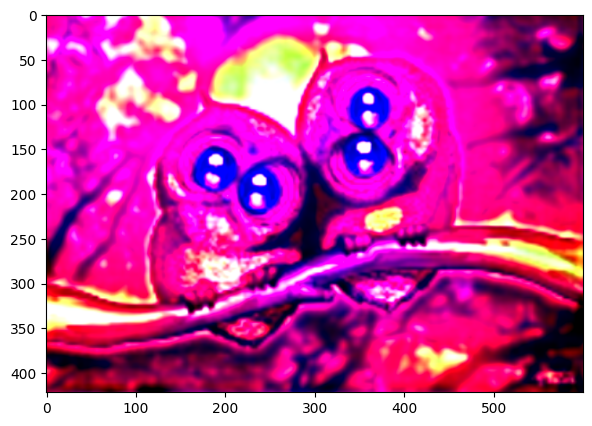

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu1_1_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



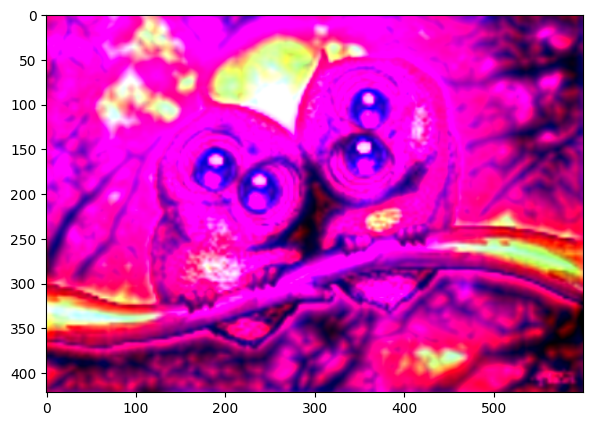

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu1_2_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



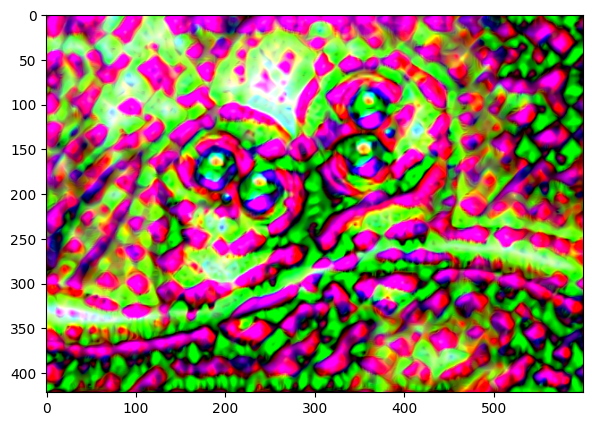

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu2_2_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



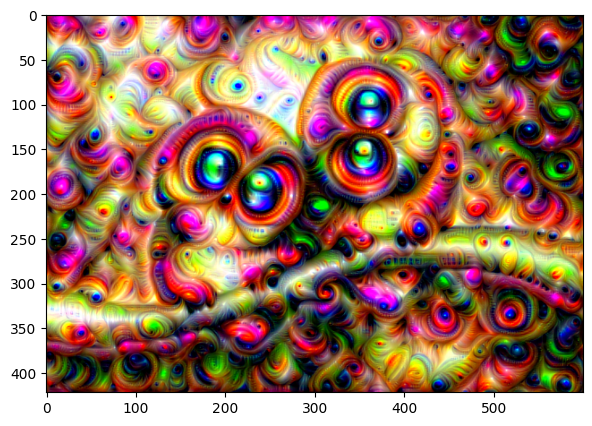

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu3_3_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



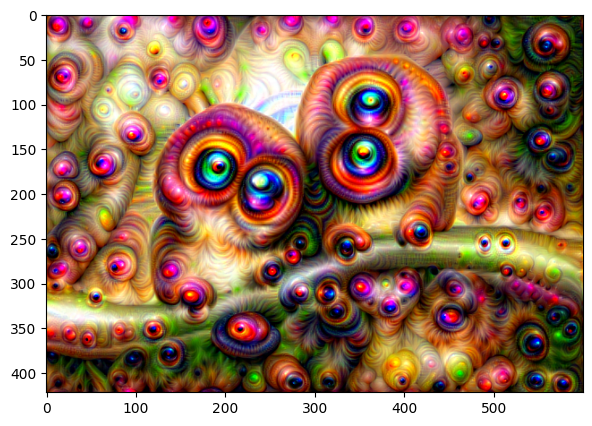

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_1_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



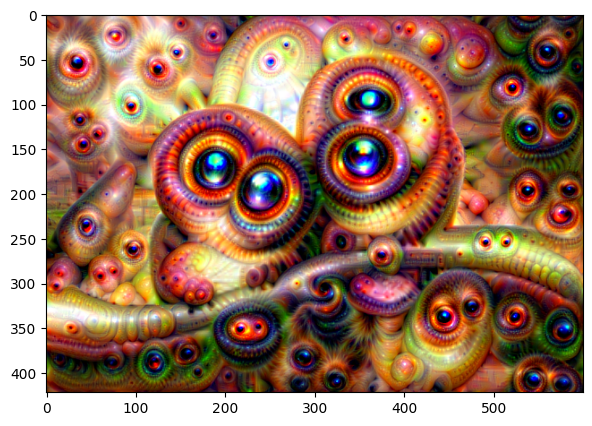

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_2_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



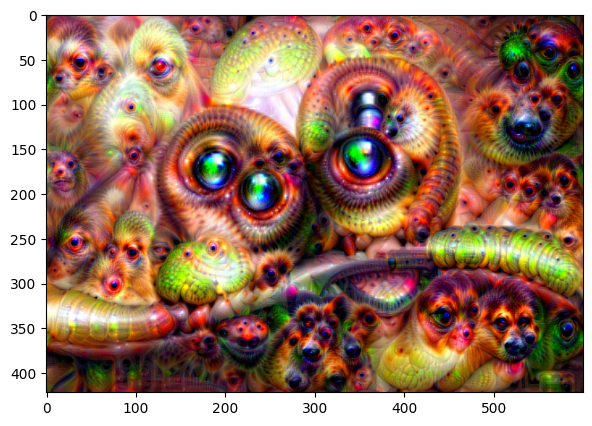

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



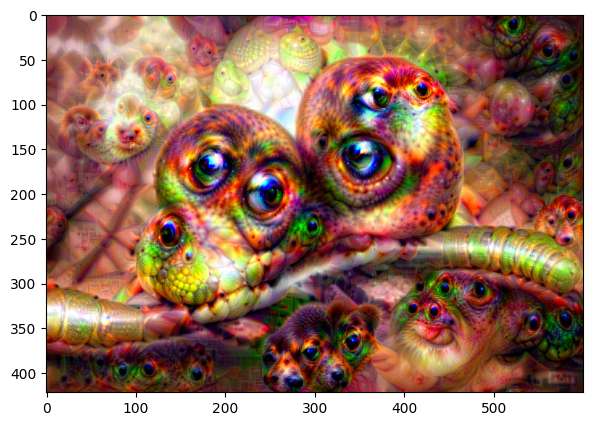

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu5_1_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



In [ ]:
exposed_layers = Vgg16Experimental(pretrained_weights=SupportedPretrainedWeights.IMAGENET.name).layer_names
exposed_layers = exposed_layers[:-3]  # truncate the ugly ones (need to keep this Jupyter notebook's filesize reasonable!)
print(f'Exposed layers = {exposed_layers}')

for layer in exposed_layers:
    config['layers_to_use'] = [layer]  # You can also use multiple layers here

    img = deep_dream_static_image(config)
    dump_path = save_and_maybe_display_image(config, img)
    print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

config['layers_to_use'] = ['relu4_3']  # keep the config consistent from cell to cell

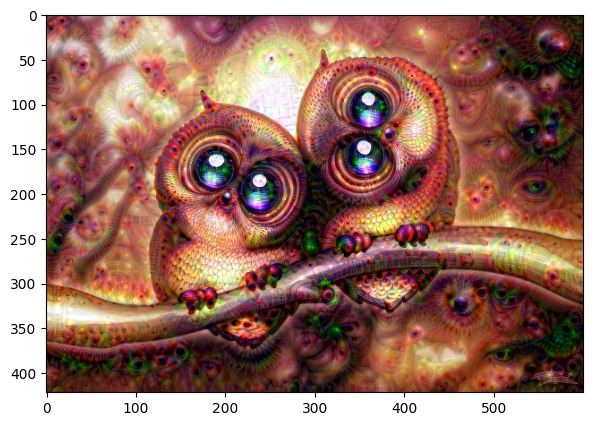

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_1_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



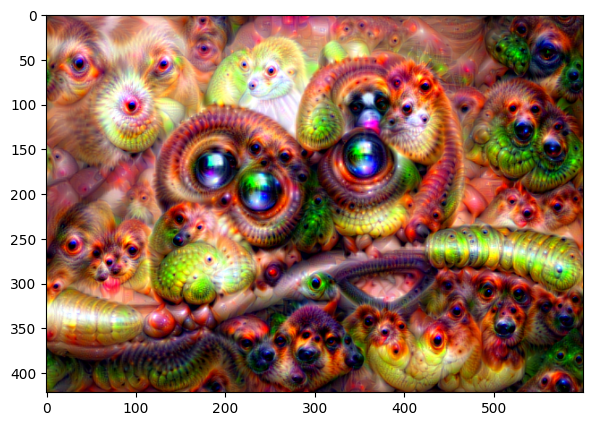

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_3_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



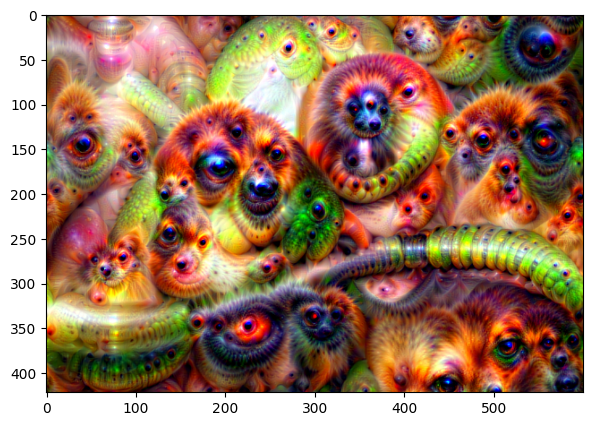

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_4_pyrratio_1.8_iter_10_lr_0.09_shift_32_smooth_0.5.jpg



In [ ]:
pyramid_sizes = [1, 3, 4]  # super arbitrary, go beserk
config['pyramid_ratio'] = 1.8  # feel free to play with this one as well

for pyramid_size in pyramid_sizes:
    config['pyramid_size'] = pyramid_size

    img = deep_dream_static_image(config)
    dump_path = save_and_maybe_display_image(config, img)
    print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

config['pyramid_size'] = 3  # keep the config consistent from cell to cell

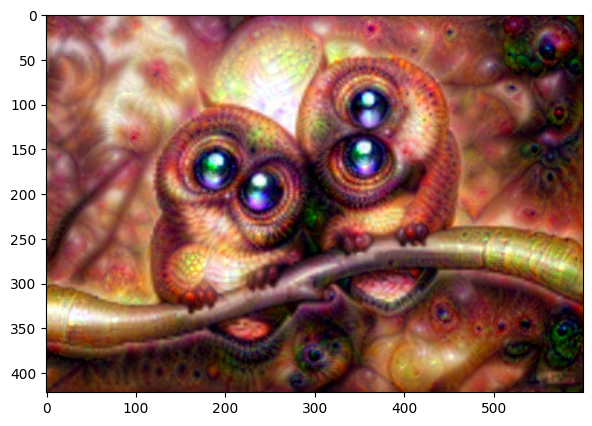

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_3_pyrratio_1.8_iter_2_lr_0.09_shift_32_smooth_0.5.jpg



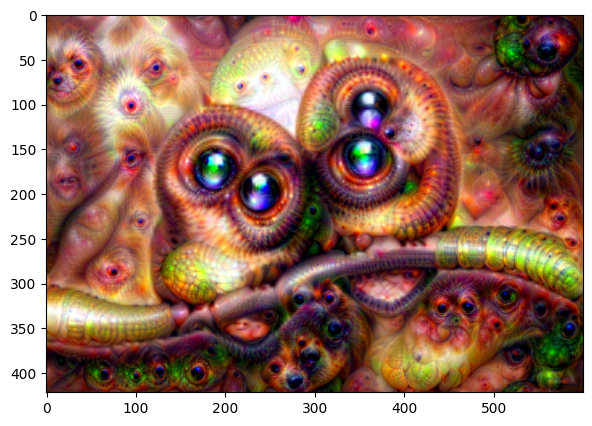

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_3_pyrratio_1.8_iter_5_lr_0.09_shift_32_smooth_0.5.jpg



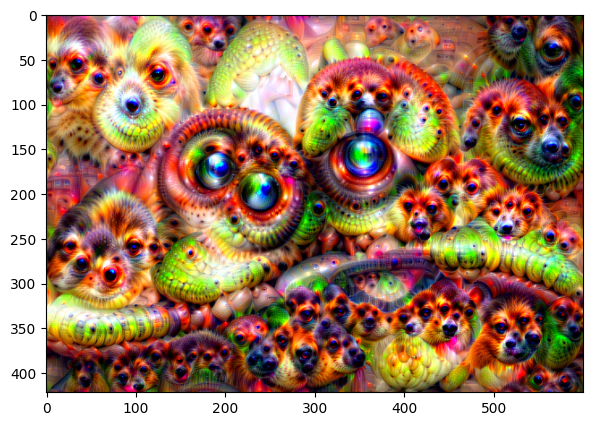

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_600_model_VGG16_EXPERIMENTAL_IMAGENET_relu4_3_pyrsize_3_pyrratio_1.8_iter_20_lr_0.09_shift_32_smooth_0.5.jpg



In [ ]:
num_gradient_ascent_iterations = [2, 5, 20]
config['lr'] = 0.09  # feel free to play with this one as well

for num_iter in num_gradient_ascent_iterations:
    config['num_gradient_ascent_iterations'] = num_iter

    img = deep_dream_static_image(config)
    dump_path = save_and_maybe_display_image(config, img)
    print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

config['num_gradient_ascent_iterations'] = 10  # keep the config consistent from cell to cell

In [ ]:
from torch.hub import download_url_to_file

class ResNet50(torch.nn.Module):

    def __init__(self, pretrained_weights, requires_grad=False, show_progress=False):
        super().__init__()
        if pretrained_weights == SupportedPretrainedWeights.IMAGENET.name:
            resnet50 = models.resnet50(pretrained=True, progress=show_progress).eval()
            
        elif pretrained_weights == SupportedPretrainedWeights.PLACES_365.name:
            resnet50 = models.resnet50(pretrained=False, progress=show_progress).eval()

            binary_name = 'resnet50_places365.pth.tar'
            resnet50_places365_binary_path = os.path.join(BINARIES_PATH, binary_name)

            if os.path.exists(resnet50_places365_binary_path):
                state_dict = torch.load(resnet50_places365_binary_path)['state_dict']
            else:
                binary_url = r'http://places2.csail.mit.edu/models_places365/resnet50_places365.pth.tar'
                print(f'Downloading {binary_name} from {binary_url} it may take some time.')
                download_url_to_file(binary_url, resnet50_places365_binary_path)
                print('Done downloading.')
                state_dict = torch.load(resnet50_places365_binary_path)['state_dict']

            new_state_dict = {}  # modify key names and make it compatible with current PyTorch model naming scheme
            for old_key in state_dict.keys():
                new_key = old_key[7:]
                new_state_dict[new_key] = state_dict[old_key]

            resnet50.fc = torch.nn.Linear(resnet50.fc.in_features, 365)
            resnet50.load_state_dict(new_state_dict, strict=True)
        else:
            raise Exception(f'Pretrained weights {pretrained_weights} not yet supported for {self.__class__.__name__} model.')

        self.layer_names = ['layer1', 'layer2', 'layer3', 'layer4']

        self.conv1 = resnet50.conv1
        self.bn1 = resnet50.bn1
        self.relu = resnet50.relu
        self.maxpool = resnet50.maxpool

        # 3
        self.layer10 = resnet50.layer1[0]
        self.layer11 = resnet50.layer1[1]
        self.layer12 = resnet50.layer1[2]

        # 4
        self.layer20 = resnet50.layer2[0]
        self.layer21 = resnet50.layer2[1]
        self.layer22 = resnet50.layer2[2]
        self.layer23 = resnet50.layer2[3]

        # 6
        self.layer30 = resnet50.layer3[0]
        self.layer31 = resnet50.layer3[1]
        self.layer32 = resnet50.layer3[2]
        self.layer33 = resnet50.layer3[3]
        self.layer34 = resnet50.layer3[4]
        self.layer35 = resnet50.layer3[5]

        # 3
        self.layer40 = resnet50.layer4[0]
        self.layer41 = resnet50.layer4[1]
        # self.layer42 = resnet50.layer4[2]

        # Go even deeper into ResNet's BottleNeck module for layer 42
        self.layer42_conv1 = resnet50.layer4[2].conv1
        self.layer42_bn1 = resnet50.layer4[2].bn1
        self.layer42_conv2 = resnet50.layer4[2].conv2
        self.layer42_bn2 = resnet50.layer4[2].bn2
        self.layer42_conv3 = resnet50.layer4[2].conv3
        self.layer42_bn3 = resnet50.layer4[2].bn3
        self.layer42_relu = resnet50.layer4[2].relu

        # Set these to False so that PyTorch won't be including them in its autograd engine - eating up precious memory
        if not requires_grad:
            for param in self.parameters():
                param.requires_grad = False

    # Feel free to experiment with different layers
    def forward(self, x):
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.maxpool(x)
        x = self.layer10(x)
        layer10 = x
        x = self.layer11(x)
        layer11 = x
        x = self.layer12(x)
        layer12 = x
        x = self.layer20(x)
        layer20 = x
        x = self.layer21(x)
        layer21 = x
        x = self.layer22(x)
        layer22 = x
        x = self.layer23(x)
        layer23 = x
        x = self.layer30(x)
        layer30 = x
        x = self.layer31(x)
        layer31 = x
        x = self.layer32(x)
        layer32 = x
        x = self.layer33(x)
        layer33 = x
        x = self.layer34(x)
        layer34 = x
        x = self.layer35(x)
        layer35 = x
        x = self.layer40(x)
        layer40 = x
        x = self.layer41(x)
        layer41 = x

        layer42_identity = layer41
        x = self.layer42_conv1(x)
        layer420 = x
        x = self.layer42_bn1(x)
        layer421 = x
        x = self.layer42_relu(x)
        layer422 = x
        x = self.layer42_conv2(x)
        layer423 = x
        x = self.layer42_bn2(x)
        layer424 = x
        x = self.layer42_relu(x)
        layer425 = x
        x = self.layer42_conv3(x)
        layer426 = x
        x = self.layer42_bn3(x)
        layer427 = x
        x += layer42_identity
        layer428 = x
        x = self.relu(x)
        layer429 = x

        # Feel free to experiment with different layers, layer35 is my favourite
        net_outputs = namedtuple("ResNet50Outputs", self.layer_names)
        # You can see the potential ambiguity arising here if we later want to reconstruct images purely from the filename
        out = net_outputs(layer10, layer23, layer34, layer40)
        return out

  0%|          | 0.00/92.8M [00:00<?, ?B/s]

Done downloading.


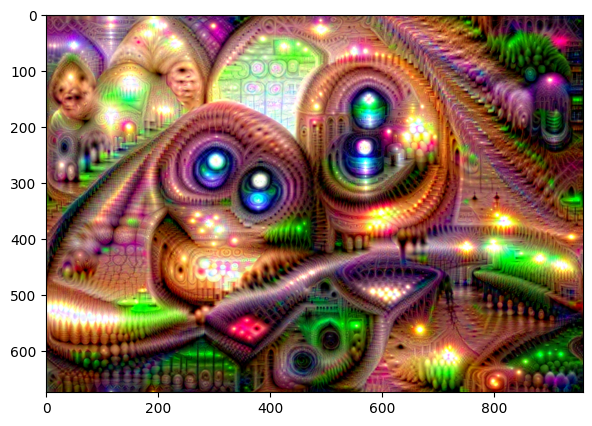

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/owls_width_960_model_RESNET50_PLACES_365_layer3_pyrsize_4_pyrratio_1.8_iter_10_lr_0.09_shift_40_smooth_0.5.jpg



In [ ]:
config['input'] = 'owls.jpeg'
config['img_width'] = 960
config['model_name'] = SupportedModels.RESNET50.name
config['pretrained_weights'] = SupportedPretrainedWeights.PLACES_365.name
config['layers_to_use'] = ['layer3']  # layer34 was used
config['pyramid_size'] = 4
config['pyramid_ratio'] = 1.8
config['num_gradient_ascent_iterations'] = 10
config['lr'] = 0.09
config['spatial_shift_size'] = 40

img = deep_dream_static_image(config)
dump_path = save_and_maybe_display_image(config, img)
print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

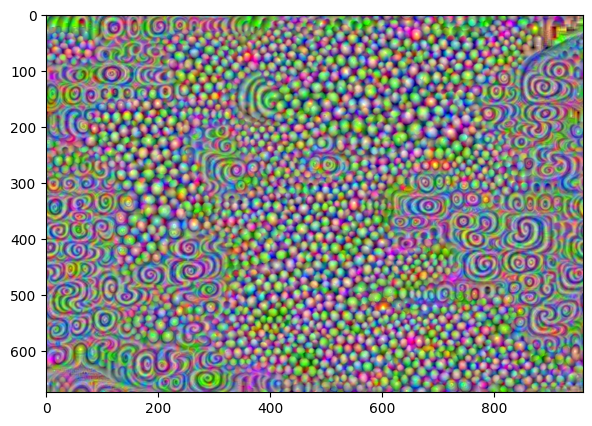

Saved DeepDream static image to: data/out-images/VGG16_EXPERIMENTAL_IMAGENET/rand_noise_width_960_model_RESNET50_PLACES_365_layer3_pyrsize_4_pyrratio_1.8_iter_10_lr_0.09_shift_40_smooth_0.5.jpg



In [ ]:
config['use_noise'] = True  # variable under test
config['layers_to_use'] = ["layer3"]
config['should_display'] = True

img = deep_dream_static_image(config)
dump_path = save_and_maybe_display_image(config, img)
print(f'Saved DeepDream static image to: {os.path.relpath(dump_path)}\n')

config['use_noise'] = False  # keep the config consistent from cell to cell